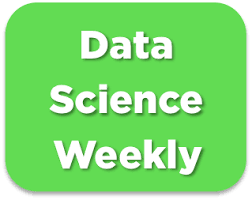

# Challenge : predict conversions 🏆🏆

This is the template that shows the different steps of the challenge. In this notebook, all the training/predictions steps are implemented for a very basic model (logistic regression with only one variable). Please use this template and feel free to change the preprocessing/training steps to get the model with the best f1-score ! May the force be with you 🧨🧨  

**For a detailed description of this project, please refer to *02-Conversion_rate_challenge.ipynb*.**

# Import libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score, GridSearchCV
from sklearn.metrics import accuracy_score, f1_score, ConfusionMatrixDisplay, confusion_matrix
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier, StackingClassifier
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) # to avoid deprecation warnings

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio


# Read file with labels

In [2]:
data = pd.read_csv('conversion_data_train.csv')

In [3]:
# Basic stats
print("Number of rows and columns : {}".format(data.shape))#[0]))
print()

print("Display of dataset: ")
display(data.head())
print()

print("Basic statistics: ")
data_desc = data.describe(include="all")
display(data_desc)
print()

print("Percentage of missing values: ")
display(100 * data.isnull().sum() / data.shape[0])
print()

print("Number of unique values: ")
display(data.nunique())

#print('Set with labels (our train+test) :', data.shape)

Number of rows and columns : (284580, 6)

Display of dataset: 


,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0



Basic statistics: 


,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000



Percentage of missing values: 


country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64


Number of unique values: 


country                 4
age                    60
new_user                2
source                  3
total_pages_visited    29
converted               2
dtype: int64

In [4]:
df6 = data.groupby('new_user')['converted'].mean().reset_index()
fig = px.pie(df6, names = "new_user", values = "converted")
fig.show()

In [5]:
df4 = data.groupby('country')['converted'].mean().reset_index()
fig = px.pie(df4, names = "country", values = "converted")
fig.show()

In [6]:
df5 = data.groupby('source')['converted'].mean().reset_index()
fig = px.pie(df5, names = "source", values = "converted")
fig.show()

In [7]:
# Distribution of each numeric variable
num_features = ["age", "total_pages_visited"]
for f in num_features:
    fig = px.histogram(
        data, f, color="converted", facet_row="converted", histnorm="probability")
    fig.show()

In [8]:
fig = px.box(data, x = 'converted', y = 'age')
fig.show()

In [9]:
fig = px.box(data, x = 'converted', y = 'total_pages_visited')
fig.show()

In [10]:
# Age contain outliers

df1 = data.copy()
Q1 = df1["age"].quantile(0.25)
Q3 = df1["age"].quantile(0.75)
IQR = Q3 - Q1

df1 = df1[df1["age"] <= (Q3+(1.5*IQR))]
df1 = df1[df1["age"] >= (Q1-(1.5*IQR))]
df1 = df1.reset_index(drop=True)
display(df1.head())
print('Before removal of outliers, The dataset had {} samples.'.format(data.shape[0]))
print('After removal of outliers, The dataset now has {} samples.'.format(df1.shape[0]))

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


Before removal of outliers, The dataset had 284580 samples.
After removal of outliers, The dataset now has 283211 samples.


In [11]:
# Select only numerical columns for the correlation matrix
numeric_columns = df1.select_dtypes(include=['float64', 'int64'])

# # Calculate the correlation matrix
corr_matrix = numeric_columns.corr().round(2)

import plotly.figure_factory as ff
fig = ff.create_annotated_heatmap(corr_matrix.values,
                                   x=corr_matrix.columns.tolist(),
                                   y=corr_matrix.index.tolist())

fig.update_layout(height=500, width=600)
fig.show()

## BASELINE MODEL: Simple UNIVARIATE Logistic Model

**From the EDA, we know that the most useful feature is total_pages_visited. 
Let's create a baseline model by using at first only this feature : in the next cells, we'll make preprocessings and train a simple (univariate) logistic regression.**

In [12]:
features_list = ['total_pages_visited']
target_variable = 'converted'

In [13]:
X = df1.loc[:, features_list]
Y = df1.loc[:, target_variable]

In [14]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=0, stratify = Y)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



In [15]:
#Training Pipeline
print("Encoding categorical features and standardizing numerical features...")

featureencoder = StandardScaler()
X_train = featureencoder.fit_transform(X_train)
print("...Done")
print(X_train[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[ 0.93580479]
 [-1.1578629 ]
 [ 1.53399556]
 [-0.26057675]
 [-0.55967213]]


In [16]:
# Train model
print("Train model...")
classifier = LogisticRegression() # 
classifier.fit(X_train, Y_train)
print("...Done.")

Train model...


...Done.


In [17]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]


In [18]:
# Test pipeline
print("Encoding categorical features and standardizing numerical features...")

X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[1.53399556]
 [0.93580479]
 [0.93580479]
 [0.63670941]
 [0.03851864]]


In [19]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]


## Performance assessment

In [20]:
# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

f1-score on train set :  0.6982843797718494
f1-score on test set :  0.6891180804041255


## Our baseline model reaches a f1-score of almost 70%.

In [21]:
# You can also check more performance metrics to better understand what your model is doing
print("Confusion matrix on train set : ")
print(confusion_matrix(Y_train, Y_train_pred))
print()
print("Confusion matrix on test set : ")
print(confusion_matrix(Y_test, Y_test_pred))
print()

Confusion matrix on train set : 
[[191001    827]
 [  2532   3887]]

Confusion matrix on test set : 
[[81850   363]
 [ 1114  1637]]



## NOW, Train MULTIVARIATE Models

In [22]:
target_variable = "converted"

X = df1.drop(target_variable, axis=1)
Y = df1.loc[:, target_variable]

X.head()
Y.head()

0    0
1    0
2    1
3    0
4    0
Name: converted, dtype: int64

In [23]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=0, stratify = Y)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



In [24]:
 #Create pipeline 
numeric_features = ["age", "total_pages_visited"] 
numeric_transformer = Pipeline(steps=[('scaler', StandardScaler())])

categorical_features = ["country", "new_user", "source"]
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(drop='first')) ])

feature_encoder = ColumnTransformer(transformers=[
        ('cat', categorical_transformer, categorical_features),    
        ('num', numeric_transformer, numeric_features)])

In [25]:

X_train = feature_encoder.fit_transform(X_train)
X_test  = feature_encoder.transform(X_test)


In [26]:
# Label encoding
print("Encoding labels...") #label encoding on the target Y_train/Y_test, because it's categorical
encoder = LabelEncoder()

Y_train = encoder.fit_transform(Y_train)
Y_test  = encoder.transform(Y_test)


Encoding labels...


In [27]:
# Train model

classifier = LogisticRegression(max_iter=1000) 
classifier.fit(X_train, Y_train)

# Predictions 
Y_train_pred = classifier.predict(X_train)
Y_test_pred = classifier.predict(X_test)

# Print scores
print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred))
print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred))
print()

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))
print()

accuracy on training set :  0.9862847861506101
accuracy on test set :  0.9859352196224284

f1-score on training set :  0.7653404677655994
f1-score on test set :  0.7591211449304576



In [28]:
scores_df = pd.DataFrame(columns = ['model', 'set', 'Accuracy', 'F1-Score'])

In [29]:
scores_df = scores_df._append({'model': 'Log Reg', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred), 'F1-Score': f1_score(Y_train, Y_train_pred)}, ignore_index = True)
scores_df = scores_df._append({'model': 'Log Reg', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred),   'F1-Score': f1_score(Y_test, Y_test_pred)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121


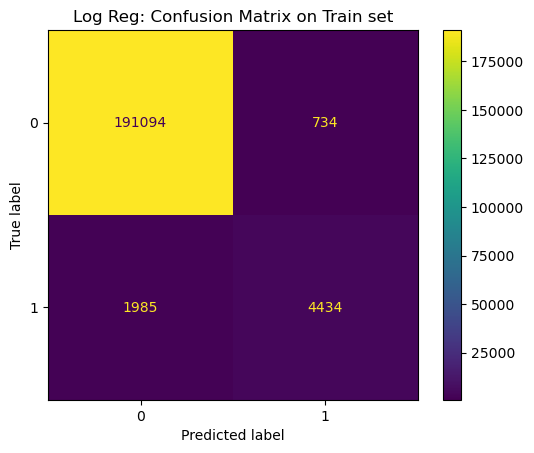

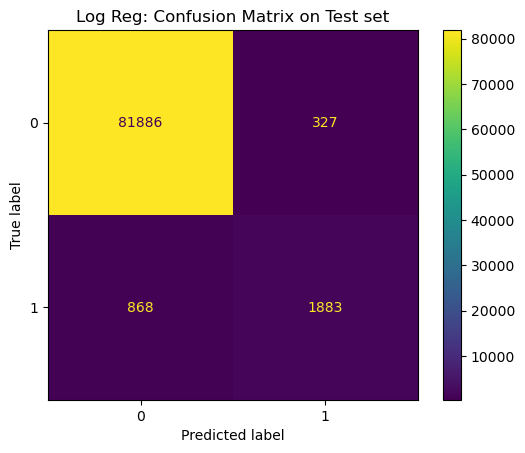

In [30]:
# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Log Reg: Confusion Matrix on Train set") 
ConfusionMatrixDisplay.from_estimator(classifier, X_train, Y_train, ax=ax) 
plt.show()

_ , ax = plt.subplots()
ax.set(title="Log Reg: Confusion Matrix on Test set") 
ConfusionMatrixDisplay.from_estimator(classifier, X_test, Y_test, ax=ax) 
plt.show()

In [31]:
column_names = []
for name, pipeline, features_list in feature_encoder.transformers_: # loop over pipelines
    if name == 'num': # if pipeline is for numeric variables
        features = features_list # just get the names of columns to which it has been applied
    else: # if pipeline is for categorical variables
        features = pipeline.named_steps['encoder'].get_feature_names_out() # get output columns names from OneHotEncoder
    column_names.extend(features) # concatenate features names
        
print("Names of columns corresponding to each coefficient: ", column_names)

Names of columns corresponding to each coefficient:  ['x0_Germany', 'x0_UK', 'x0_US', 'x1_1', 'x2_Direct', 'x2_Seo', 'age', 'total_pages_visited']


In [32]:
# Create a pandas DataFrame
coefs = pd.DataFrame(index = column_names, data = classifier.coef_.transpose(), columns=["coefficients"])
coefs

,coefficients
x0_Germany,3.427342
x0_UK,3.192267
x0_US,2.863004
x1_1,-1.718698
x2_Direct,-0.248366
x2_Seo,-0.024517
age,-0.577167
total_pages_visited,2.527172


In [33]:
# Plot coefficients
coefs["Color"] = np.where(coefs["coefficients"]<0, 'red', 'green')
fig = px.bar(coefs["coefficients"], orientation = 'v', title="Features Correlation Coefficients: Log Regression")
fig.update_layout(showlegend = False, height=500, width=850, margin = {'l': 100})
fig.update_traces(marker_color=coefs["Color"])               
fig.show()

In [34]:
# Compute abs() and sort values for feature importance
feature_importance = abs(coefs['coefficients']).sort_values()

# Plot coefficients
fig = px.bar(feature_importance, orientation = 'h', title="Features importance on convertion rate: Log Regression")
fig.update_layout(showlegend = False, height=600, width=600, margin = {'l': 100}) # to avoid cropping of column names               
fig.show()

In [35]:
#print('Coefficients of the Logistic regression model:')
#classifier.coef_

In [36]:
logistic_regression = LogisticRegression(max_iter=1000)
param_grid = {'C': [0.05, 0.06, 0.07, 0.08, 0.09]}
grid_search = GridSearchCV(logistic_regression, param_grid, cv=3) # cv number of folds to be used in CV
grid_search.fit(X_train, Y_train)

print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: ", grid_search.best_score_)

train_accuracy = grid_search.best_estimator_.score(X_train, Y_train)
test_accuracy = grid_search.best_estimator_.score(X_test, Y_test)
print()
print("Train Accuracy: ", train_accuracy)
print("Test Accuracy: ", test_accuracy)

Best Parameters:  {'C': 0.09}
Best Accuracy:  0.9862898301334395

Train Accuracy:  0.9862898303631329
Test Accuracy:  0.9857822136434254


In [37]:
# Predictions 
Y_train_pred_LRGS = grid_search.best_estimator_.predict(X_train)
Y_test_pred_LRGS = grid_search.best_estimator_.predict(X_test)

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_LRGS))
print("f1-score on test set : ",     f1_score(Y_test, Y_test_pred_LRGS))
print()

f1-score on training set :  0.7643080124869928
f1-score on test set :  0.7555645487656819



In [38]:
# You can also check more performance metrics to better understand what your model is doing
print("Confusion matrix on train set : ")
print(confusion_matrix(Y_train, Y_train_pred_LRGS))
print()
print("Confusion matrix on test set : ")
print(confusion_matrix(Y_test, Y_test_pred_LRGS))
print()

Confusion matrix on train set : 
[[191122    706]
 [  2012   4407]]

Confusion matrix on test set : 
[[81889   324]
 [  884  1867]]



In [39]:
scores_df = scores_df._append({'model': 'LogReg_GS', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_LRGS), 'F1-Score': f1_score(Y_train, Y_train_pred_LRGS)}, ignore_index = True)
scores_df = scores_df._append({'model': 'LogReg_GS', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_LRGS),   'F1-Score': f1_score(Y_test, Y_test_pred_LRGS)}, ignore_index = True)
scores_df


,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565


In [40]:
# Perform grid search
print("Grid search...")
logistic_regression = LogisticRegression(max_iter=1000)  # max_iter changed because of convergence warning
model = BaggingClassifier(estimator=logistic_regression)

# Grid of values to be tested
#params = {"estimator__C": [0.5, 0.6, 0.7], "n_estimators": [9, 10, 11, 12],} # 0.5, 11 f1-score on training set :  0.765593995341213  f1-score on test set :  0.758565094719871
#params = {"estimator__C": [0.3, 0.4, 0.5,], "n_estimators": [9, 10, 11, 12],}  # 0.4, 10 f1-score on training set :  0.7652038700760193 f1-score on test set :  0.7593863544610416
#params = {"estimator__C": [0.3, 0.4, 0.5, 0.6], "n_estimators": [9, 10, 11, 12],}  # 0.3, 11 f1-score on training set :  0.7660894287929697  f1-score on test set :  0.7593712212817413
#params = {"estimator__C": [0.5, 0.6, 0.7,], "n_estimators": [8, 10, 12,],} # 0.5, 12 f1-score on training set :  0.7641264904095386 f1-score on test set :  0.7595396729254997

params = {"estimator__C": [0.5, 0.6, 0.7,], "n_estimators": [8, 10, 13,],} # 0.6, 13 f1-score on training set :  0.7647262048713076 f1-score on test set :  0.7603305785123967

print(params)
gridsearch_Bag = GridSearchCV(model, param_grid=params, cv=3) 
gridsearch_Bag.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch_Bag.best_params_)
print("Best validation accuracy : ", gridsearch_Bag.best_score_)
print()
print("Accuracy on training set : ", gridsearch_Bag.score(X_train, Y_train))
print("Accuracy on test set : ", gridsearch_Bag.score(X_test, Y_test))

Grid search...
{'estimator__C': [0.5, 0.6, 0.7], 'n_estimators': [8, 10, 13]}
...Done.
Best hyperparameters :  {'estimator__C': 0.5, 'n_estimators': 10}
Best validation accuracy :  0.9862948740660792

Accuracy on training set :  0.9862696535130419
Accuracy on test set :  0.9859705286945059


In [41]:
# Predictions 
Y_train_pred_Bagging = gridsearch_Bag.best_estimator_.predict(X_train)
Y_test_pred_Bagging = gridsearch_Bag.best_estimator_.predict(X_test)
print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_Bagging))
print("f1-score on test set : ",     f1_score(Y_test, Y_test_pred_Bagging))
print()

f1-score on training set :  0.7651828847481021
f1-score on test set :  0.7597742845626764



In [42]:
scores_df = scores_df._append({'model': 'LogReg_Bagging', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_Bagging), 'F1-Score': f1_score(Y_train, Y_train_pred_Bagging)}, ignore_index = True)
scores_df = scores_df._append({'model': 'LogReg_Bagging', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_Bagging),   'F1-Score': f1_score(Y_test, Y_test_pred_Bagging)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774


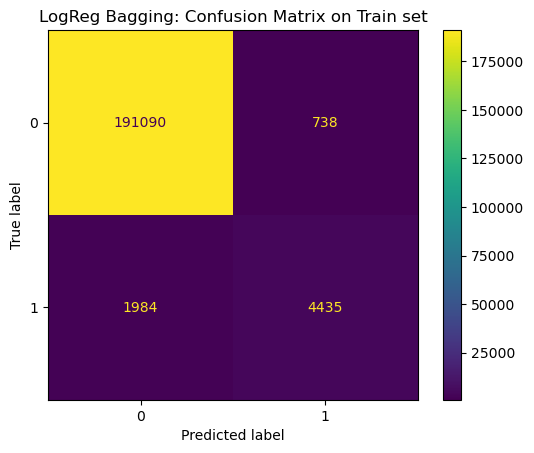

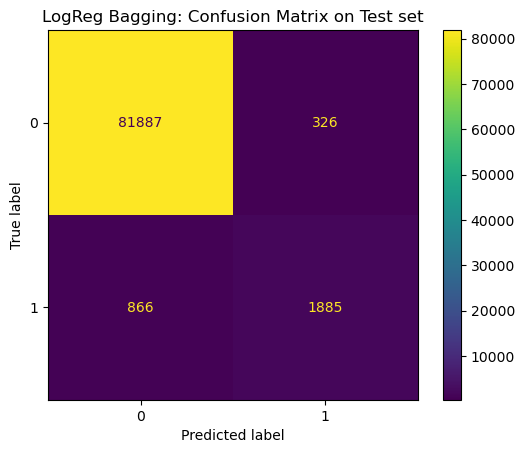

In [43]:
# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="LogReg Bagging: Confusion Matrix on Train set") 
ConfusionMatrixDisplay.from_estimator(gridsearch_Bag, X_train, Y_train, ax=ax) 
plt.show()

_ , ax = plt.subplots()
ax.set(title="LogReg Bagging: Confusion Matrix on Test set") 
ConfusionMatrixDisplay.from_estimator(gridsearch_Bag, X_test, Y_test, ax=ax) 
plt.show()

In [44]:
# Perform grid search
print("Grid search...")
logistic_regression = LogisticRegression(max_iter=1000) 
model_ada = AdaBoostClassifier(estimator=logistic_regression)

# Grid of values to be tested
# params = {'estimator__C': [0.9, 1, 2], 'n_estimators': [39, 45, 47, 51]} # 2, 51  f1-score on training set :  0.7611279826464208 f1-score on test set :  0.7529411764705882
# params = { "estimator__C": [1, 2, 3, 4], "n_estimators": [47, 51, 55, 58],} # 4, 58 f1-score on training set :  0.7646042170756999 f1-score on test set :  0.7575328614762387

params = { "estimator__C": [5, 6, 7, 8,], "n_estimators": [59, 60, 61, ],} # 5, 60 f1-score on training set :  0.7652788552710973 f1-score on test set :  0.7581752119499394

print(params)
gridsearch_ada = GridSearchCV(model_ada, param_grid=params, cv=3)  
gridsearch_ada.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch_ada.best_params_)
print("Best validation accuracy : ", gridsearch_ada.best_score_)
print()
print("Accuracy on training set : ", gridsearch_ada.score(X_train, Y_train))
print("Accuracy on test set : ", gridsearch_ada.score(X_test, Y_test))

Grid search...
{'estimator__C': [5, 6, 7, 8], 'n_estimators': [59, 60, 61]}


/Users/wenhajindomeni/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.

/Users/wenhajindomeni/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.

/Users/wenhajindomeni/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.

/Users/wenhajindomeni/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



...Done.
Best hyperparameters :  {'estimator__C': 5, 'n_estimators': 60}
Best validation accuracy :  0.9863200949505866

Accuracy on training set :  0.9862646093005191
Accuracy on test set :  0.9858999105503508


In [45]:
# Predictions 
Y_train_pred_Ada = gridsearch_ada.best_estimator_.predict(X_train)
Y_test_pred_Ada = gridsearch_ada.best_estimator_.predict(X_test)
print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_Ada))
print("f1-score on test set : ",     f1_score(Y_test, Y_test_pred_Ada))
print()

f1-score on training set :  0.7652788552710973
f1-score on test set :  0.7581752119499394



In [46]:
scores_df = scores_df._append({'model': 'LogReg_AdaBoost', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_Ada), 'F1-Score': f1_score(Y_train, Y_train_pred_Ada)}, ignore_index = True)
scores_df = scores_df._append({'model': 'LogReg_AdaBoost', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_Ada),   'F1-Score': f1_score(Y_test, Y_test_pred_Ada)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774
6,LogReg_AdaBoost,train,0.986265,0.765279
7,LogReg_AdaBoost,test,0.985900,0.758175


In [47]:
# Perform grid search
print("Grid search...")
logistic_regression = LogisticRegression(max_iter=1000)
model_GB = GradientBoostingClassifier()

# Grid of values to be tested
# params = {"max_depth": [2, 3, 4, 5],       
#          "min_samples_leaf": [1,],
#          "min_samples_split": [1, 2, 3],
#          "n_estimators": [8, 10, 11, 12],} #Best hyperparameters :  {'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 12}
                                        # f1-score on training set :  0.7330449986196742 f1-score on test set :  0.7240266724026673
# params = {"max_depth": [5, 7, 9,],      # 5 
#          "min_samples_leaf": [1,],
#          "min_samples_split": [2, ],
#          "n_estimators": [12, 15, 18, 20],} # 20f1-score on training set :  0.7553867891204521 f1-score on test set :  0.746188710341986
params = {"max_depth": [5,],      # 5 
         "min_samples_leaf": [1,],
         "min_samples_split": [2, ],
#         "n_estimators": [20, 30, 40],} # 40 f1-score on test set :  0.7590890930882941
#         "n_estimators": [38, 40, 45,],} # 38 f1-score on test set : 0.759185303514377
#         "n_estimators": [28, 35, 38,],} # 35 f1-score on test set :  0.7586895725129844
"n_estimators": [37, 38, 39,],} 

print(params)
gridsearch_GB = GridSearchCV(model_GB, param_grid=params, cv=3) 
gridsearch_GB.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch_GB.best_params_)
print("Best validation accuracy : ", gridsearch_GB.best_score_)
print()
print("Accuracy on training set : ", gridsearch_GB.score(X_train, Y_train))
print("Accuracy on test set : ", gridsearch_GB.score(X_test, Y_test))

Grid search...
{'max_depth': [5], 'min_samples_leaf': [1], 'min_samples_split': [2], 'n_estimators': [37, 38, 39]}


...Done.
Best hyperparameters :  {'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 38}
Best validation accuracy :  0.9860577963319367

Accuracy on training set :  0.9864058472511564
Accuracy on test set :  0.9858057530248105


In [48]:
# Predictions 
Y_train_pred_GB = gridsearch_GB.best_estimator_.predict(X_train)
Y_test_pred_GB = gridsearch_GB.best_estimator_.predict(X_test)
print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_GB))
print("f1-score on test set : ",     f1_score(Y_test, Y_test_pred_GB))
print()

f1-score on training set :  0.7700708130705571
f1-score on test set :  0.759185303514377



In [49]:
scores_df = scores_df._append({'model': 'LogReg_GradBoost', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_GB), 'F1-Score': f1_score(Y_train, Y_train_pred_GB)}, ignore_index = True)
scores_df = scores_df._append({'model': 'LogReg_GradBoost', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_GB),   'F1-Score': f1_score(Y_test, Y_test_pred_GB)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774
6,LogReg_AdaBoost,train,0.986265,0.765279
7,LogReg_AdaBoost,test,0.985900,0.758175
8,LogReg_GradBoost,train,0.986406,0.770071
9,LogReg_GradBoost,test,0.985806,0.759185


In [50]:
# Train model
dec_tree = DecisionTreeClassifier(criterion="entropy") 
dec_tree.fit(X_train, Y_train)

# Predictions 
Y_train_pred_DT = dec_tree.predict(X_train)
Y_test_pred_DT = dec_tree.predict(X_test)

# Print scores
print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred_DT))
print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred_DT))
print()

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_DT))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred_DT))
print()

# You can also check more performance metrics to better understand what your model is doing
print("Confusion matrix on train set : ")
print(confusion_matrix(Y_train, Y_train_pred_DT))
print()
print("Confusion matrix on test set : ")
print(confusion_matrix(Y_test, Y_test_pred_DT))
print()



accuracy on training set :  0.9887413176491952
accuracy on test set :  0.9838990631326209

f1-score on training set :  0.805439330543933
f1-score on test set :  0.7233009708737864

Confusion matrix on train set : 
[[191395    433]
 [  1799   4620]]

Confusion matrix on test set : 
[[81808   405]
 [  963  1788]]



In [51]:

scores_df = scores_df._append({'model': 'DecTree Entropy', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_DT), 'F1-Score': f1_score(Y_train, Y_train_pred_DT)}, ignore_index = True)
scores_df = scores_df._append({'model': 'DecTree Entropy', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_DT),   'F1-Score': f1_score(Y_test, Y_test_pred_DT)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774
6,LogReg_AdaBoost,train,0.986265,0.765279
7,LogReg_AdaBoost,test,0.985900,0.758175
8,LogReg_GradBoost,train,0.986406,0.770071
9,LogReg_GradBoost,test,0.985806,0.759185


In [52]:
# Train model
dec_tree = DecisionTreeClassifier(criterion="gini") 
dec_tree.fit(X_train, Y_train)

# Predictions 
Y_train_pred_DT = dec_tree.predict(X_train)
Y_test_pred_DT = dec_tree.predict(X_test)

# Print scores
print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred_DT))
print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred_DT))
print()

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_DT))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred_DT))
print()



accuracy on training set :  0.9887413176491952
accuracy on test set :  0.9838990631326209

f1-score on training set :  0.805439330543933
f1-score on test set :  0.7229647630619684



In [53]:

scores_df = scores_df._append({'model': 'DecTree Gini', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_DT), 'F1-Score': f1_score(Y_train, Y_train_pred_DT)}, ignore_index = True)
scores_df = scores_df._append({'model': 'DecTree Gini', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_DT),   'F1-Score': f1_score(Y_test, Y_test_pred_DT)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774
6,LogReg_AdaBoost,train,0.986265,0.765279
7,LogReg_AdaBoost,test,0.985900,0.758175
8,LogReg_GradBoost,train,0.986406,0.770071
9,LogReg_GradBoost,test,0.985806,0.759185


In [54]:
classifierDT = DecisionTreeClassifier(criterion="entropy")
# params = {
#     "max_depth": [2, 4, 6, 8, 10],# 8
#     "min_samples_leaf": [1, 2, 5], # 2
#     "min_samples_split": [2, 4, 8],} # 2, F1 test: 0.7445552615509872
params = {
    "max_depth": [6, 7, 8, 9],# 8
    "min_samples_leaf": [1, 2], # 2
    "min_samples_split": [1, 2],} # 2 F1 test: 0.7445552615509872

gridsearchDT = GridSearchCV(classifierDT, param_grid=params, cv=3)  # cv : the number of folds to be used for CV

gridsearchDT.fit(X_train, Y_train)
print("Best hyperparameters : ", gridsearchDT.best_params_)
print("Best validation accuracy : ", gridsearchDT.best_score_)
print()
# Predictions 
Y_train_pred_DTGS = gridsearchDT.predict(X_train)
Y_test_pred_DTGS = gridsearchDT.predict(X_test)

# Print scores
print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred_DTGS))
print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred_DTGS))
print()

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_DTGS))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred_DTGS))
print()

/Users/wenhajindomeni/anaconda3/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:547: FitFailedWarning:


24 fits failed out of a total of 48.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
24 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/wenhajindomeni/anaconda3/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/wenhajindomeni/anaconda3/lib/python3.11/site-packages/sklearn/base.py", line 1467, in wrapper
    estimator._validate_params()
  File "/Users/wenhajindomeni/anaconda3/lib/python3.11/site-packages/sklearn/base.py", line 666, in _validate_params
    validate_p

Best hyperparameters :  {'max_depth': 8, 'min_samples_leaf': 2, 'min_samples_split': 2}
Best validation accuracy :  0.9851801030476041

accuracy on training set :  0.9860628407996086
accuracy on test set :  0.9852290381808766

f1-score on training set :  0.7596764373314778
f1-score on test set :  0.7445552615509872



In [55]:
scores_df = scores_df._append({'model': 'DecTree_Entropy_Opt', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_DTGS), 'F1-Score': f1_score(Y_train, Y_train_pred_DTGS)}, ignore_index = True)
scores_df = scores_df._append({'model': 'DecTree_Entropy_Opt', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_DTGS),   'F1-Score': f1_score(Y_test, Y_test_pred_DTGS)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774
6,LogReg_AdaBoost,train,0.986265,0.765279
7,LogReg_AdaBoost,test,0.985900,0.758175
8,LogReg_GradBoost,train,0.986406,0.770071
9,LogReg_GradBoost,test,0.985806,0.759185


In [56]:
classifierDT = DecisionTreeClassifier(criterion="gini")
#params = {
#     "max_depth": [8, 9, 10, 11],# 9
#     "min_samples_leaf": [2, 3, 4, 5], # 4
#     "min_samples_split": [2, 3, 4, 5],} # 5, f1-score on test set :  0.7499498696611189
# params = {
#     "max_depth": [6, 7, 8, 9],# 9
#     "min_samples_leaf": [1, 2], # 2
#     "min_samples_split": [1, 2],} # 2 F1 test: 0.7494981934965878

params = {
     "max_depth": [9],# 9
     "min_samples_leaf": [4], # 4
#     "min_samples_split": [5, 6, 7, 8, 9, 10],} # 10 f1-score on test set :  0.7502004811547714
#     "min_samples_split": [10, 20, 30],} # 20 f1-score on test set :  0.7518615415576575
     "min_samples_split": [20, 24, 25],} # 20 f1-score on test set :  0.7518615415576575
gridsearchDT = GridSearchCV(classifierDT, param_grid=params, cv=3)  # cv : the number of folds to be used for CV

gridsearchDT.fit(X_train, Y_train)
print("Best hyperparameters : ", gridsearchDT.best_params_)
print("Best validation accuracy : ", gridsearchDT.best_score_)
print()
# Predictions 
Y_train_pred_DTGS = gridsearchDT.predict(X_train)
Y_test_pred_DTGS = gridsearchDT.predict(X_test)

# Print scores
print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred_DTGS))
print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred_DTGS))
print()

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_DTGS))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred_DTGS))
print()

Best hyperparameters :  {'max_depth': 9, 'min_samples_leaf': 4, 'min_samples_split': 20}
Best validation accuracy :  0.9852255018762935

accuracy on training set :  0.9865874389019759
accuracy on test set :  0.9854879713761122

f1-score on training set :  0.7705978776637046
f1-score on test set :  0.7518615415576575



In [57]:
scores_df = scores_df._append({'model': 'DecTree_Gini_Opt', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_DTGS), 'F1-Score': f1_score(Y_train, Y_train_pred_DTGS)}, ignore_index = True)
scores_df = scores_df._append({'model': 'DecTree_Gini_Opt', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_DTGS),   'F1-Score': f1_score(Y_test, Y_test_pred_DTGS)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774
6,LogReg_AdaBoost,train,0.986265,0.765279
7,LogReg_AdaBoost,test,0.985900,0.758175
8,LogReg_GradBoost,train,0.986406,0.770071
9,LogReg_GradBoost,test,0.985806,0.759185


In [58]:
# Train model

RF = RandomForestClassifier(criterion="gini")
RF.fit(X_train, Y_train)

# Predictions 
Y_train_pred_RF = RF.predict(X_train)
Y_test_pred_RF = RF.predict(X_test)

# Print scores
print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred_RF))
print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred_RF))
print()

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_RF))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred_RF))
print()



accuracy on training set :  0.9887362734366725
accuracy on test set :  0.9842756932347818

f1-score on training set :  0.8099412715975828
f1-score on test set :  0.7358639778568604



In [59]:

scores_df = scores_df._append({'model': 'RF Gini', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_RF), 'F1-Score': f1_score(Y_train, Y_train_pred_RF)}, ignore_index = True)
scores_df = scores_df._append({'model': 'RF Gini', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_RF),   'F1-Score': f1_score(Y_test, Y_test_pred_RF)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774
6,LogReg_AdaBoost,train,0.986265,0.765279
7,LogReg_AdaBoost,test,0.985900,0.758175
8,LogReg_GradBoost,train,0.986406,0.770071
9,LogReg_GradBoost,test,0.985806,0.759185


In [60]:
# Train model

RF = RandomForestClassifier(criterion="entropy")
RF.fit(X_train, Y_train)

# Predictions 
Y_train_pred_RF = RF.predict(X_train)
Y_test_pred_RF = RF.predict(X_test)

# Print scores
print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred_RF))
print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred_RF))
print()

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_RF))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred_RF))
print()

accuracy on training set :  0.9887413176491952
accuracy on test set :  0.9844404689044772

f1-score on training set :  0.8100425531914893
f1-score on test set :  0.738425009893154



In [61]:
scores_df = scores_df._append({'model': 'RF Entropy', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_RF), 'F1-Score': f1_score(Y_train, Y_train_pred_RF)}, ignore_index = True)
scores_df = scores_df._append({'model': 'RF Entropy', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_RF),   'F1-Score': f1_score(Y_test, Y_test_pred_RF)}, ignore_index = True)
scores_df

,model,set,Accuracy,F1-Score
0,Log Reg,train,0.986285,0.765340
1,Log Reg,test,0.985935,0.759121
2,LogReg_GS,train,0.986290,0.764308
3,LogReg_GS,test,0.985782,0.755565
4,LogReg_Bagging,train,0.986270,0.765183
5,LogReg_Bagging,test,0.985971,0.759774
6,LogReg_AdaBoost,train,0.986265,0.765279
7,LogReg_AdaBoost,test,0.985900,0.758175
8,LogReg_GradBoost,train,0.986406,0.770071
9,LogReg_GradBoost,test,0.985806,0.759185


In [62]:
scores_test = scores_df[scores_df["set"] == "test"]
scores_train = scores_df[scores_df["set"] == "train"]

In [63]:
EMC = scores_test.copy()
EMC.index = ['Log Reg','LogReg_GS','LogReg_Bagging','LogReg_AdaBoost','LogReg_GradBoost', 'DecTree Entropy', 'DecTree Gini', 'DecTree_Entropy_Opt', 'DecTree_Gini_Opt', 'RF Gini', 'RF Entropy']
EMC

,model,set,Accuracy,F1-Score
Log Reg,Log Reg,test,0.985935,0.759121
LogReg_GS,LogReg_GS,test,0.985782,0.755565
LogReg_Bagging,LogReg_Bagging,test,0.985971,0.759774
LogReg_AdaBoost,LogReg_AdaBoost,test,0.985900,0.758175
LogReg_GradBoost,LogReg_GradBoost,test,0.985806,0.759185
DecTree Entropy,DecTree Entropy,test,0.983899,0.723301
DecTree Gini,DecTree Gini,test,0.983899,0.722965
DecTree_Entropy_Opt,DecTree_Entropy_Opt,test,0.985229,0.744555
DecTree_Gini_Opt,DecTree_Gini_Opt,test,0.985488,0.751862
RF Gini,RF Gini,test,0.984276,0.735864


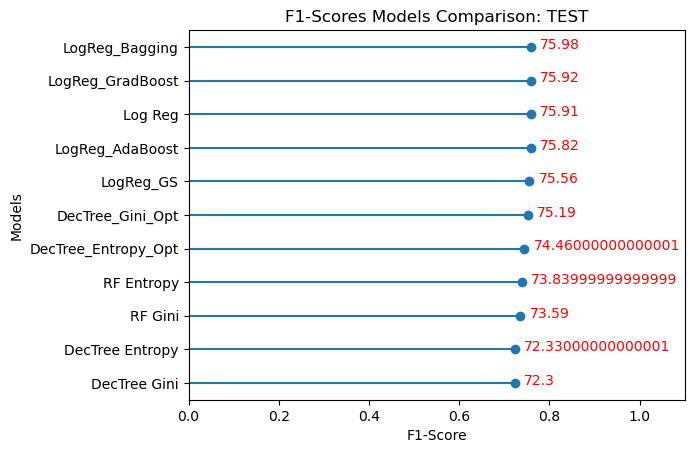

In [64]:
R2 = round(EMC['F1-Score'].sort_values(ascending=True), 4)
plt.hlines(y=R2.index, xmin=0, xmax=R2.values)
plt.plot(R2.values, R2.index,'o')
plt.title('F1-Scores Models Comparison: TEST')
plt.xlabel('F1-Score')
plt.ylabel('Models')
for i, v in enumerate(R2):
    plt.text(v + 0.02, i - 0.05, str(v*100), color='red')
plt.xlim([0,1.1])
plt.show()

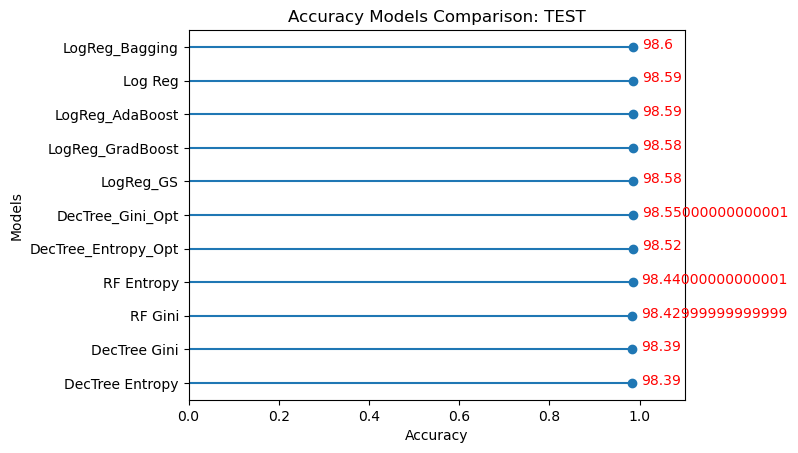

In [65]:
R2 = round(EMC['Accuracy'].sort_values(ascending=True), 4)
plt.hlines(y=R2.index, xmin=0, xmax=R2.values)
plt.plot(R2.values, R2.index,'o')
plt.title('Accuracy Models Comparison: TEST')
plt.xlabel('Accuracy')
plt.ylabel('Models')
for i, v in enumerate(R2):
    plt.text(v + 0.02, i - 0.05, str(v*100), color='red')
plt.xlim([0,1.1])
plt.show()

In [66]:
EMC1 = scores_train.copy()
EMC1.index = ['Log Reg','LogReg_GS','LogReg_Bagging','LogReg_AdaBoost','LogReg_GradBoost', 'DecTree Entropy', 'DecTree Gini', 'DecTree_Entropy_Opt', 'DecTree_Gini_Opt', 'RF Gini', 'RF Entropy']
EMC1

,model,set,Accuracy,F1-Score
Log Reg,Log Reg,train,0.986285,0.765340
LogReg_GS,LogReg_GS,train,0.986290,0.764308
LogReg_Bagging,LogReg_Bagging,train,0.986270,0.765183
LogReg_AdaBoost,LogReg_AdaBoost,train,0.986265,0.765279
LogReg_GradBoost,LogReg_GradBoost,train,0.986406,0.770071
DecTree Entropy,DecTree Entropy,train,0.988741,0.805439
DecTree Gini,DecTree Gini,train,0.988741,0.805439
DecTree_Entropy_Opt,DecTree_Entropy_Opt,train,0.986063,0.759676
DecTree_Gini_Opt,DecTree_Gini_Opt,train,0.986587,0.770598
RF Gini,RF Gini,train,0.988736,0.809941


In [67]:
# classifier = RandomForestClassifier(criterion="entropy") 
# params = {
#     "max_depth": [2, 4, 6, 8, 10],
#     "min_samples_leaf": [1, 2, 5],
#     "min_samples_split": [2, 4, 8],
#     "n_estimators": [10, 20, 40, 60, 80, 100]}
# gridsearch = GridSearchCV(classifier, param_grid=params, cv=3)  # cv : the number of folds to be used for CV

# gridsearch.fit(X_train, Y_train)

# # Predictions 
# Y_train_pred_RF = gridsearch.predict(X_train)
# Y_test_pred_RF = gridsearch.predict(X_test)

# # Print scores
# print("accuracy on training set : ", accuracy_score(Y_train, Y_train_pred_RF))
# print("accuracy on test set : ", accuracy_score(Y_test, Y_test_pred_RF))
# print()

# print("f1-score on training set : ", f1_score(Y_train, Y_train_pred_RF))
# print("f1-score on test set : ", f1_score(Y_test, Y_test_pred_RF))
# print()

# scores_df = scores_df._append({'model': 'RFEntropy_Opt', 'set': 'train', 'Accuracy': accuracy_score(Y_train, Y_train_pred_RF), 'F1-Score': f1_score(Y_train, Y_train_pred_RF)}, ignore_index = True)
# scores_df = scores_df._append({'model': 'RFEntropy_Opt', 'set': 'test',  'Accuracy': accuracy_score(Y_test, Y_test_pred_RF),   'F1-Score': f1_score(Y_test, Y_test_pred_RF)}, ignore_index = True)
# scores_df